#Import

In [1]:
import numpy as np
from stl import mesh
import stl

In [2]:
import open3d as o3d
import sys
import os
sys.path.append(os.path.expanduser(r'C:\Users\Emman\anaconda3\Lib\site-packages\open3d\examples'))
import open3d_example as o3dtut

In [3]:
print("Testing mesh in Open3D...")
path=r"C:\Users\Emman\Desktop\JE\Ortho\gitFolder\STL-Segmentation\OrthoCAD_Export_43495989\43495989_shell_occlusion_l.stl"
mesh = o3d.io.read_triangle_mesh(path)
print(mesh)
print('Vertices:')
print(np.asarray(mesh.vertices))
print('Triangles:')
print(np.asarray(mesh.triangles))

Testing mesh in Open3D...
TriangleMesh with 569634 points and 189878 triangles.
Vertices:
[[-26.16896248  -4.02895355  20.53007126]
 [-25.80494308  -4.0744133   20.7734108 ]
 [-26.34581375  -3.88300133  20.5393219 ]
 ...
 [ -7.50197935  26.27416611  12.49399662]
 [ -8.43974495  26.27416992  12.49399662]
 [ -7.50197887  26.13253784  12.49401665]]
Triangles:
[[     0      1      2]
 [     3      4      5]
 [     6      7      8]
 ...
 [569625 569626 569627]
 [569628 569629 569630]
 [569631 569632 569633]]


In [4]:
print("Try to render a mesh with normals (exist: " +
      str(mesh.has_vertex_normals()) + ") and colors (exist: " +
      str(mesh.has_vertex_colors()) + ")")
o3d.visualization.draw_geometries([mesh])
print("A mesh with no normals and no colors does not look good.")

In [ ]:
print("Computing normal and rendering it.")
mesh.compute_vertex_normals()
print(np.asarray(mesh.triangle_normals))
o3d.visualization.draw_geometries([mesh])

Computing normal and rendering it.
[[-4.85552802e-01 -6.26961190e-01  6.09227496e-01]
 [-5.47415832e-01 -6.93038139e-01  4.69077867e-01]
 [-5.41896810e-01 -7.59713993e-01  3.59419667e-01]
 ...
 [ 2.87611404e-10  1.41406518e-04  9.99999990e-01]
 [ 4.06785784e-06  9.99999999e-01  4.58051799e-05]
 [ 5.75221698e-10  1.41406518e-04  9.99999990e-01]]
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The requested transformation operation is not supported. 
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The requested transformation operation is not supported. 
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The requested transformation operation is not supported. 
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The handle is invalid. 
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The handle is invalid. 
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The requested transformation operat

In [ ]:
import copy
print("We make a partial mesh of only the first half triangles.")
mesh1 = copy.deepcopy(mesh)
mesh1.triangles = o3d.utility.Vector3iVector(
    np.asarray(mesh1.triangles)[len(mesh1.triangles) // 30:, :])
mesh1.triangle_normals = o3d.utility.Vector3dVector(
    np.asarray(mesh1.triangle_normals)[len(mesh1.triangle_normals) // 30:, :])
print(mesh1.triangles)
o3d.visualization.draw_geometries([mesh1])

We make a partial mesh of only the first half triangles.
std::vector<Eigen::Vector3i> with 183549 elements.
Use numpy.asarray() to access data.


In [ ]:
print("Painting the mesh")
mesh.paint_uniform_color([1, 0.706, 0])
o3d.visualization.draw_geometries([mesh])

Painting the mesh


In [ ]:
def check_properties(name, mesh):
    mesh.compute_vertex_normals()

    edge_manifold = mesh.is_edge_manifold(allow_boundary_edges=True)
    edge_manifold_boundary = mesh.is_edge_manifold(allow_boundary_edges=False)
    vertex_manifold = mesh.is_vertex_manifold()
    self_intersecting = mesh.is_self_intersecting()
    watertight = mesh.is_watertight()
    orientable = mesh.is_orientable()

    print(name)
    print(f"  edge_manifold:          {edge_manifold}")
    print(f"  edge_manifold_boundary: {edge_manifold_boundary}")
    print(f"  vertex_manifold:        {vertex_manifold}")
    print(f"  self_intersecting:      {self_intersecting}")
    print(f"  watertight:             {watertight}")
    print(f"  orientable:             {orientable}")

    geoms = [mesh]
    if not edge_manifold:
        edges = mesh.get_non_manifold_edges(allow_boundary_edges=True)
        geoms.append(o3dtut.edges_to_lineset(mesh, edges, (1, 0, 0)))
    if not edge_manifold_boundary:
        edges = mesh.get_non_manifold_edges(allow_boundary_edges=False)
        geoms.append(o3dtut.edges_to_lineset(mesh, edges, (0, 1, 0)))
    if not vertex_manifold:
        verts = np.asarray(mesh.get_non_manifold_vertices())
        pcl = o3d.geometry.PointCloud(
            points=o3d.utility.Vector3dVector(np.asarray(mesh.vertices)[verts]))
        pcl.paint_uniform_color((0, 0, 1))
        geoms.append(pcl)
    if self_intersecting:
        intersecting_triangles = np.asarray(
            mesh.get_self_intersecting_triangles())
        intersecting_triangles = intersecting_triangles[0:1]
        intersecting_triangles = np.unique(intersecting_triangles)
        print("  # visualize self-intersecting triangles")
        triangles = np.asarray(mesh.triangles)[intersecting_triangles]
        edges = [
            np.vstack((triangles[:, i], triangles[:, j]))
            for i, j in [(0, 1), (1, 2), (2, 0)]
        ]
        edges = np.hstack(edges).T
        edges = o3d.utility.Vector2iVector(edges)
        geoms.append(o3dtut.edges_to_lineset(mesh, edges, (1, 0, 1)))
    o3d.visualization.draw_geometries(geoms, mesh_show_back_face=True)

In [ ]:
print('input')
# fit to unit cube
mesh.scale(1 / np.max(mesh.get_max_bound() - mesh.get_min_bound()),
           center=mesh.get_center())
o3d.visualization.draw_geometries([mesh])

print('voxelization')
voxel_grid = o3d.geometry.VoxelGrid.create_from_triangle_mesh(mesh,
                                                              voxel_size=0.005)
o3d.visualization.draw_geometries([voxel_grid])

In [ ]:
print('voxelization')
voxel_grid = o3d.geometry.VoxelGrid.create_from_triangle_mesh(mesh,
                                                              voxel_size=0.0005)
o3d.visualization.draw_geometries([voxel_grid])

voxelization


In [ ]:
check_properties('Teeth', mesh)

In [ ]:
print('create noisy mesh')
mesh_in = mesh
vertices = np.asarray(mesh_in.vertices)
noise = 5
vertices += np.random.uniform(0, noise, size=vertices.shape)
mesh_in.vertices = o3d.utility.Vector3dVector(vertices)
mesh_in.compute_vertex_normals()
o3d.visualization.draw_geometries([mesh_in])

print('filter with average with 1 iteration')
mesh_out = mesh_in.filter_smooth_simple(number_of_iterations=1)
mesh_out.compute_vertex_normals()
o3d.visualization.draw_geometries([mesh_out])

print('filter with average with 5 iterations')
mesh_out = mesh_in.filter_smooth_simple(number_of_iterations=5)
mesh_out.compute_vertex_normals()
o3d.visualization.draw_geometries([mesh_out])

create noisy mesh
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The handle is invalid. 
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The requested transformation operation is not supported. 
filter with average with 1 iteration
filter with average with 5 iterations


In [ ]:
print('filter with Laplacian with 10 iterations')
mesh_out = mesh_in.filter_smooth_laplacian(number_of_iterations=10)
mesh_out.compute_vertex_normals()
o3d.visualization.draw_geometries([mesh_out])

print('filter with Laplacian with 50 iterations')
mesh_out = mesh_in.filter_smooth_laplacian(number_of_iterations=50)
mesh_out.compute_vertex_normals()
o3d.visualization.draw_geometries([mesh_out])

filter with Laplacian with 10 iterations
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The requested transformation operation is not supported. 
filter with Laplacian with 50 iterations


In [ ]:
print('filter with Taubin with 10 iterations')
mesh_out = mesh_in.filter_smooth_taubin(number_of_iterations=10)
mesh_out.compute_vertex_normals()
o3d.visualization.draw_geometries([mesh_out])

print('filter with Taubin with 100 iterations')
mesh_out = mesh_in.filter_smooth_taubin(number_of_iterations=100)
mesh_out.compute_vertex_normals()
o3d.visualization.draw_geometries([mesh_out])

filter with Taubin with 10 iterations
filter with Taubin with 100 iterations
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The requested transformation operation is not supported. 


In [ ]:
mesh.compute_vertex_normals()
o3d.visualization.draw_geometries([mesh])
pcd = mesh.sample_points_uniformly(number_of_points=100)
o3d.visualization.draw_geometries([pcd])

In [ ]:
pcd = mesh.sample_points_uniformly(number_of_points=11000)
o3d.visualization.draw_geometries([pcd])

[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The handle is invalid. 
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The handle is invalid. 
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The handle is invalid. 
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The handle is invalid. 


In [ ]:
mesh.compute_vertex_normals()

o3d.visualization.draw_geometries([mesh])
pcd = mesh.sample_points_uniformly(number_of_points=500)
o3d.visualization.draw_geometries([pcd])

In [ ]:
mesh.compute_vertex_normals()
print(
    f'The mesh has {len(mesh.vertices)} vertices and {len(mesh.triangles)} triangles'
)
o3d.visualization.draw_geometries([mesh], zoom=0.8, mesh_show_wireframe=True)
mesh = mesh.subdivide_midpoint(number_of_iterations=1)
print(
    f'After subdivision it has {len(mesh.vertices)} vertices and {len(mesh.triangles)} triangles'
)
o3d.visualization.draw_geometries([mesh], zoom=0.8, mesh_show_wireframe=True)

The mesh has 568723 vertices and 189878 triangles


TypeError: draw_geometries(): incompatible function arguments. The following argument types are supported:
    1. (geometry_list: List[open3d.cpu.pybind.geometry.Geometry], window_name: str = 'Open3D', width: int = 1920, height: int = 1080, left: int = 50, top: int = 50, point_show_normal: bool = False, mesh_show_wireframe: bool = False, mesh_show_back_face: bool = False) -> None
    2. (geometry_list: List[open3d.cpu.pybind.geometry.Geometry], window_name: str = 'Open3D', width: int = 1920, height: int = 1080, left: int = 50, top: int = 50, point_show_normal: bool = False, mesh_show_wireframe: bool = False, mesh_show_back_face: bool = False, lookat: numpy.ndarray[numpy.float64[3, 1]], up: numpy.ndarray[numpy.float64[3, 1]], front: numpy.ndarray[numpy.float64[3, 1]], zoom: float) -> None

Invoked with: [TriangleMesh with 568723 points and 189878 triangles.]; kwargs: zoom=0.8, mesh_show_wireframe=True

In [ ]:

mesh_in = copy.deepcopy(mesh)
mesh_in.compute_vertex_normals()

print(
    f'Input mesh has {len(mesh_in.vertices)} vertices and {len(mesh_in.triangles)} triangles'
)
o3d.visualization.draw_geometries([mesh_in])

voxel_size = max(mesh_in.get_max_bound() - mesh_in.get_min_bound()) / 32
print(f'voxel_size = {voxel_size:e}')
mesh_smp = mesh_in.simplify_vertex_clustering(
    voxel_size=voxel_size,
    contraction=o3d.geometry.SimplificationContraction.Average)
print(
    f'Simplified mesh has {len(mesh_smp.vertices)} vertices and {len(mesh_smp.triangles)} triangles'
)
o3d.visualization.draw_geometries([mesh_smp])

voxel_size = max(mesh_in.get_max_bound() - mesh_in.get_min_bound()) / 16
print(f'voxel_size = {voxel_size:e}')
mesh_smp = mesh_in.simplify_vertex_clustering(
    voxel_size=voxel_size,
    contraction=o3d.geometry.SimplificationContraction.Average)
print(
    f'Simplified mesh has {len(mesh_smp.vertices)} vertices and {len(mesh_smp.triangles)} triangles'
)
o3d.visualization.draw_geometries([mesh_smp])

Input mesh has 568723 vertices and 189878 triangles
voxel_size = 2.738695e+00
Simplified mesh has 2374 vertices and 84258 triangles
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The requested transformation operation is not supported. 
voxel_size = 5.477390e+00
Simplified mesh has 530 vertices and 6814 triangles


In [ ]:
print("Generate data")

mesh.compute_vertex_normals()

mesh = mesh.subdivide_midpoint(number_of_iterations=2)
vert = np.asarray(mesh.vertices)
min_vert, max_vert = vert.min(axis=0), vert.max(axis=0)
for _ in range(30):
    cube = o3d.geometry.TriangleMesh.create_box()
    cube.scale(0.005, center=cube.get_center())
    cube.translate(
        (
            np.random.uniform(min_vert[0], max_vert[0]),
            np.random.uniform(min_vert[1], max_vert[1]),
            np.random.uniform(min_vert[2], max_vert[2]),
        ),
        relative=False,
    )
    mesh += cube
mesh.compute_vertex_normals()
print("Show input mesh")
o3d.visualization.draw_geometries([mesh])

Generate data
Show input mesh


In [ ]:
print("Cluster connected triangles")
with o3d.utility.VerbosityContextManager(
        o3d.utility.VerbosityLevel.Debug) as cm:
    triangle_clusters, cluster_n_triangles, cluster_area = (
        mesh.cluster_connected_triangles())
triangle_clusters = np.asarray(triangle_clusters)
cluster_n_triangles = np.asarray(cluster_n_triangles)
cluster_area = np.asarray(cluster_area)
o3d.visualization.draw_geometries([mesh])

Cluster connected triangles
[Open3D DEBUG] [ClusterConnectedTriangles] Compute triangle adjacency
[Open3D DEBUG] [ClusterConnectedTriangles] Done computing triangle adjacency
[Open3D DEBUG] [ClusterConnectedTriangles] Done clustering, #clusters=189501
[Open3D WARNING] GLFW Error: WGL: Failed to make context current: The requested transformation operation is not supported. 


In [ ]:
print("Show mesh with small clusters removed")
mesh_0 = copy.deepcopy(mesh)
triangles_to_remove = cluster_n_triangles[triangle_clusters] < 100
mesh_0.remove_triangles_by_mask(triangles_to_remove)
o3d.visualization.draw_geometries([mesh_0])

Show mesh with small clusters removed


In [ ]:
print("Show largest cluster")
mesh_1 = copy.deepcopy(mesh)
largest_cluster_idx = cluster_n_triangles.argmax()
triangles_to_remove = triangle_clusters != largest_cluster_idx
mesh_1.remove_triangles_by_mask(triangles_to_remove)
o3d.visualization.draw_geometries([mesh_1])

Show largest cluster


#Code

In [ ]:
# Load the STL file and extract the vertices and faces
path=r"C:\Users\Emman\Desktop\JE\Ortho\OrthoCAD_Export_43495989\43495989_shell_occlusion_l.stl"
stl_file = mesh.Mesh.from_file(path)
vertices = stl_file.vectors.reshape(-1, 3)
faces = np.arange(len(vertices)).reshape(-1, 3)

# Print the number of vertices and faces in the mesh
print(f"Number of vertices: {len(vertices)}")
print(f"Number of faces: {len(faces)}")


Number of vertices: 569634
Number of faces: 189878


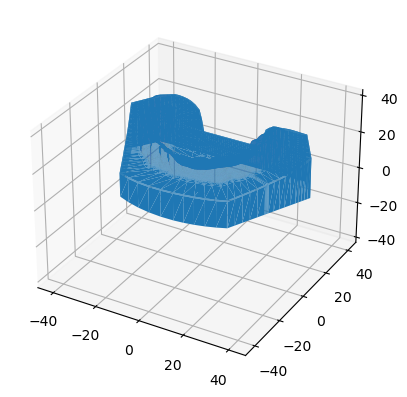

In [ ]:
from stl import mesh
from mpl_toolkits import mplot3d
from matplotlib import pyplot

# Create a new plot
figure = pyplot.figure()
axes = figure.add_subplot(projection='3d')
normal_vectors=stl_file.get_unit_normals()
# Load the STL files and add the vectors to the plot
your_mesh = mesh.Mesh.from_file(path)
axes.add_collection3d(mplot3d.art3d.Poly3DCollection(your_mesh.vectors))
axes.plot(normal_vectors[:,0],normal_vectors[:,1],normal_vectors[:,2])
# Auto scale to the mesh size
scale = your_mesh.points.flatten()
axes.auto_scale_xyz(scale, scale, scale)

# Show the plot to the screen
pyplot.show()

In [ ]:
import trimesh
path=r"C:\Users\Emman\Desktop\JE\Ortho\OrthoCAD_Export_43495989\43495989_shell_occlusion_l.stl"
mesh=trimesh.load(path)
trimesh.decomposition.convex_decomposition(mesh)


[]

In [ ]:
trimesh.repair.fill_holes(mesh)

False

In [ ]:
trimesh.repair.broken_faces(mesh,color=125)

array([ 572,  869,  574,  576,  578,  580,  870, 1214, 1215, 1612, 1843,
       1613, 1615, 1617, 1619, 1621, 1623, 1625, 1627, 1629, 1631, 1633,
       1635, 1637, 1639, 1641, 1643, 1645, 1647, 1649, 1651, 1653, 1655,
       1657, 1659, 1661, 1663, 1665, 1667, 1669, 1671, 1673, 1675, 1677,
       1679, 1681, 1683, 1685, 1687, 1689, 1691, 1693, 1695, 1697, 1699,
       1701, 1703, 1705, 1707, 1709, 1711, 1713, 1715, 1717, 1719, 1721,
       1723, 1725, 1727, 1729, 1731, 1733, 1735, 1737, 1739, 1741, 1743,
       1745, 1747, 1749, 1751, 1753, 1755, 1757, 1759, 1761, 1763, 1765,
       1767, 1769, 1771, 1773, 1775, 1777, 1779, 1781, 1783, 1785, 1787,
       1789, 1791, 1793, 1795, 1797, 1799, 1801, 1803, 1805, 1807, 1809,
       1811, 1813, 1815, 1817, 1819, 1821, 1823, 1825, 1827, 1829, 1831,
       1833, 1835, 1837, 1839, 1841])

In [ ]:
def to_binary(number):
    assert(number<8)
    if number>3:
        return np.array(list(np.binary_repr(number)),dtype=int)
    else:
        res=np.zeros(3)
        if number>1:
            res[1:]=np.array(list(np.binary_repr(number)),dtype=int)
        else:
            res[2:]=np.array(list(np.binary_repr(number)),dtype=int)
        return res

In [ ]:
import sklearn

In [ ]:
import trimesh
import numpy as np
from sklearn.cluster import KMeans
import open3d as o3d

import matplotlib.pyplot as plt
path=r"C:\Users\Emman\Desktop\JE\Ortho\OrthoCAD_Export_43495989\43495989_shell_occlusion_l.stl"
mesh = trimesh.load(path)
# Extract mesh vertices as features
vertices = mesh.vertices
faces = mesh.faces
# Perform K-means clustering
num_clusters = 8  # Number of desired clusters
kmeans = KMeans(n_clusters=num_clusters)
labels = kmeans.fit_predict(faces)

# Assign the cluster labels to the mesh faces
face_colors = np.zeros((len(mesh.faces), 3))
for face_index, label in enumerate(labels):
    face_colors[face_index] = to_binary(label)

# Set the face colors in the mesh
mesh.visual.vertex_colors = np.ones(len(mesh.vertices), dtype=np.uint8) * 255
mesh.visual.face_colors = face_colors

# Visualize the segmented mesh
mesh.show()

c:\Users\Emman\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
from sklearn.cluster import DBSCAN
X=mesh.copy()
clustering = DBSCAN(eps=3.5, min_samples=7,n_jobs=-1).fit(X.faces)
clustering.labels_,clustering

# Assign the cluster labels to the mesh faces
face_colors = np.zeros((len(mesh.faces), 3))
for face_index, label in enumerate(clustering.labels_):
    if label!=-1:
        face_colors[face_index] = to_binary(label)

# Set the face colors in the mesh
mesh.visual.vertex_colors = np.ones(len(mesh.vertices), dtype=np.uint8) * 255
mesh.visual.face_colors = face_colors

# Visualize the segmented mesh
mesh.show()

In [ ]:
len(mesh.faces)

189878

In [ ]:
len(np.unique(X[1]))

142379

In [ ]:
from sklearn.cluster import SpectralClustering
import numpy as np
import trimesh
path=r"C:\Users\Emman\Desktop\JE\Ortho\OrthoCAD_Export_43495989\43495989_shell_occlusion_l.stl"
mesh = trimesh.load(path)

print("sampling")
X=trimesh.sample.sample_surface_even(mesh,1_000_000)
print("start clustering")
clustering = SpectralClustering(n_clusters=2,assign_labels='discretize',affinity='nearest_neighbors',random_state=0,n_jobs=-1).fit(X[0])
print('end clustering')
# Assign the cluster labels to the mesh faces
face_colors = np.zeros((len(mesh.faces), 3))
#for i in range(1000000):
for i in range(len(clustering.labels_)):
    label=clustering.label_[i]
    face_index=X[1][i]
    face_colors[face_index] = to_binary(label+1)
# Set the face colors in the mesh
mesh.visual.vertex_colors = np.ones(len(mesh.vertices), dtype=np.uint8) * 255
mesh.visual.face_colors = face_colors

# Visualize the segmented mesh
mesh.show()

sampling
start clustering


In [ ]:
from stl import mesh
from mpl_toolkits import mplot3d
from matplotlib import pyplot

# Create a new plot
figure = pyplot.figure()
axes = figure.add_subplot(projection='3d')
normal_vectors=stl_file.get_unit_normals()
# Load the STL files and add the vectors to the plot
your_mesh = mesh.Mesh.from_file(path)
axes.add_collection3d(mplot3d.art3d.Poly3DCollection(your_mesh.vectors))
axes.plot(normal_vectors[:,0],normal_vectors[:,1],normal_vectors[:,2])
# Auto scale to the mesh size
scale = your_mesh.points.flatten()
axes.auto_scale_xyz(scale, scale, scale)

# Show the plot to the screen
pyplot.show()

In [ ]:
SpectralClustering(assign_labels='discretize', n_clusters=2,random_state=0)

In [ ]:
import numpy as np
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
X = np.array([[-1, -1], [-2, -1], [1, 1], [2, 1]])
y = np.array([1, 1, 2, 2])
from sklearn.svm import SVC
clf = make_pipeline(StandardScaler(), SVC(gamma='auto'))
clf.fit(X, y)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svc', SVC(gamma='auto'))])

In [ ]:
import trimesh
import numpy as np
from sklearn.cluster import KMeans

import matplotlib.pyplot as plt
path=r"C:\Users\Emman\Desktop\JE\Ortho\OrthoCAD_Export_43495989\43495989_shell_occlusion_l.stl"

# Extract mesh vertices as features
vertices = mesh.vertices
faces = mesh.faces
# Perform K-means clustering
num_clusters = 8  # Number of desired clusters
kmeans = KMeans(n_clusters=num_clusters)
labels = kmeans.fit_predict(faces)

# Assign the cluster labels to the mesh faces
face_colors = np.zeros((len(mesh.faces), 3))
for face_index, label in enumerate(labels):
    face_colors[face_index] = to_binary(label)

# Set the face colors in the mesh
mesh.visual.vertex_colors = np.ones(len(mesh.vertices), dtype=np.uint8) * 255
mesh.visual.face_colors = face_colors*len(label)

# Visualize the segmented mesh
mesh.show()

In [ ]:
import trimesh
import numpy as np
from sklearn.cluster import KMeans

import matplotlib.pyplot as plt
path=r"C:\Users\Emman\Desktop\JE\Ortho\OrthoCAD_Export_43495989\43495989_shell_occlusion_l.stl"
mesh2=mesh.copy()
# Extract mesh vertices as features
vertices = mesh2.vertices
faces = mesh2.faces
# Perform K-means clustering
num_clusters = 8 # Number of desired clusters
kmeans = KMeans(n_clusters=num_clusters)
labels = kmeans.fit_predict(vertices)

# Assign the cluster labels to the mesh faces
vertices_colors = np.zeros((len(mesh2.vertices), 3))
for vertices_index, label in enumerate(labels):
    vertices_colors[vertices_index] = to_binary(label)

# Set the face colors in the mesh
mesh2.visual.vertices_colors = np.ones(len(mesh2.faces), dtype=np.uint8) * 255
mesh2.visual.faces_colors = vertices_colors

# Visualize the segmented mesh
mesh2.show()

c:\Users\Emman\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
import trimesh
import numpy as np
from skimage import measure

# Load the mesh using trimesh
path=r"C:\Users\Emman\Desktop\JE\Ortho\OrthoCAD_Export_43495989\43495989_shell_occlusion_l.stl"
mesh = trimesh.load_mesh(path)
# Extract mesh vertices and faces
vertices = mesh.vertices
faces = mesh.faces

# Generate random seed points
num_seeds = 5  # Number of seed points to generate
seed_points = []
min_x, max_x = np.min(vertices[:, 0]), np.max(vertices[:, 0])
min_y, max_y = np.min(vertices[:, 1]), np.max(vertices[:, 1])
min_z, max_z = np.min(vertices[:, 2]), np.max(vertices[:, 2])

for _ in range(num_seeds):
    seed = [
        np.random.uniform(min_x, max_x),
        np.random.uniform(min_y, max_y),
        np.random.uniform(min_z, max_z)
    ]
    seed_points.append(seed)

# Perform region growing segmentation
labels = np.zeros(len(vertices), dtype=int)
next_label = 1

# Define threshold for separating teeth and gum
distance_threshold = 0.75

for seed in seed_points:
    seed_index = np.argmin(np.linalg.norm(vertices - seed, axis=1))
    if labels[seed_index] != 0:
        continue
    labels[seed_index] = next_label
    queue = [seed_index]

    while len(queue) > 0:
        current = queue.pop(0)
        neighbors = np.unique(faces[np.isin(faces, current).any(axis=1)])
        for neighbor in neighbors:
            if labels[neighbor] == 0:
                distance = np.linalg.norm(vertices[neighbor] - vertices[current])
                if distance <= distance_threshold:
                    labels[neighbor] = next_label
                    queue.append(neighbor)

    next_label += 1

# Assign colors to teeth and gum regions
teeth_color = [255, 0, 0, 255]  # Red color for teeth
gum_color = [0, 255, 0, 255]  # Green color for gum

colors = np.zeros((len(vertices), 4), dtype=np.uint8)
for label in np.unique(labels):
    if label == 0:
        colors[labels == label] = gum_color
    else:
        colors[labels == label] = teeth_color

# Set the vertex colors in the mesh
mesh.visual.vertex_colors = colors

# Visualize the segmented mesh
mesh.show()


In [ ]:
import trimesh
import numpy as np
from skimage import measure

# Load the mesh using trimesh
path=r"C:\Users\Emman\Desktop\JE\Ortho\OrthoCAD_Export_43495989\43495989_shell_occlusion_l.stl"
mesh = trimesh.load_mesh(path)
# Extract mesh vertices and faces
vertices = mesh.vertices
faces = mesh.faces

# Find seed points with highest z-axis values
num_seeds = 5  # Number of seed points to use
sorted_indices = np.argsort(vertices[:, 2])  # Sort vertices by z-axis
seed_indices = sorted_indices[-num_seeds:]  # Select indices with highest z-axis values
seed_points = vertices[seed_indices]

# Perform region growing segmentation
labels = np.zeros(len(vertices), dtype=int)
next_label = 1

# Define threshold for separating teeth and gum
distance_threshold = 0.70

for seed in seed_points:
    seed_index = np.argmin(np.linalg.norm(vertices - seed, axis=1))
    if labels[seed_index] != 0:
        continue
    labels[seed_index] = next_label
    queue = [seed_index]

    while len(queue) > 0:
        current = queue.pop(0)
        neighbors = np.unique(faces[np.isin(faces, current).any(axis=1)])
        for neighbor in neighbors:
            if labels[neighbor] == 0:
                distance = np.linalg.norm(vertices[neighbor] - vertices[current])
                if distance <= distance_threshold:
                    labels[neighbor] = next_label
                    queue.append(neighbor)

    next_label += 1

# Assign colors to teeth and gum regions
teeth_color = [255, 0, 0, 255]  # Red color for teeth
gum_color = [0, 255, 0, 255]  # Green color for gum

colors = np.zeros((len(vertices), 4), dtype=np.uint8)
for label in np.unique(labels):
    if label == 0:
        colors[labels == label] = gum_color
    else:
        colors[labels == label] = teeth_color

# Set the vertex colors in the mesh
mesh.visual.vertex_colors = colors

# Visualize the segmented mesh
mesh.show()


In [ ]:
import pyvista as pv
from skimage import filters
from scipy.ndimage import label

# Load the jaw mesh using PyVista
mesh = pv.read(path)

# Set the pitch size for voxelization
pitch = 0.02

# Voxelize the mesh
voxel_grid = mesh.voxelize(pitch)

# Convert the voxel grid to a binary array
voxel_array = voxel_grid.threshold(0.5)

# Compute Hessian-based Frangi filter
frangi_image = filters.frangi(voxel_array, scale_range=(1, 10))

# Threshold the filtered image to separate teeth from gum
threshold = 0.5  # Adjust this threshold as needed
binary_image = frangi_image > threshold

# Label connected components in the binary image
labeled_image, num_labels = label(binary_image)

# Find the label with the largest connected component (teeth)
teeth_label = np.argmax(np.bincount(labeled_image.flat)[1:]) + 1

# Extract teeth vertices based on the label
teeth_indices = np.where(labeled_image == teeth_label)
teeth_vertices = mesh.points[teeth_indices]

# Set colors for teeth and gum regions
teeth_color = [255, 0, 0, 255]  # Red color for teeth
gum_color = [0, 255, 0, 255]  # Green color for gum

# Create a color array for all vertices
colors = np.array([gum_color] * mesh.n_points, dtype=np.uint8)

# Assign teeth color to the teeth vertices
colors[teeth_indices] = teeth_color

# Set the vertex colors in the mesh
mesh.point_data['colors'] = colors

# Visualize the segmented mesh
p = pv.Plotter()
p.add_mesh(mesh, color='colors')
p.show()


AttributeError: 'PolyData' object has no attribute 'voxelize'